# Visualization of Grad-CAM (Grounding) and VQA for ViCHA

In [1]:
%load_ext autoreload
%autoreload 2

In [4]:
import seaborn as sns
import matplotlib.pylab as plt
import random
import torch.nn.functional as F

# 1. Set the paths for model checkpoint and configuration

In [3]:
model_path = 'path_to_grounding_finetuned_model/checkpoint_best.pth'
bert_config_path = 'configs/config_bert.json'
use_cuda = False

# 2. Model definition

In [4]:
from functools import partial
from models.vit import VisionTransformer
from models.xbert import BertConfig, BertModel
from models.tokenization_bert import BertTokenizer

import torch
from torch import nn
from torchvision import transforms

import json

class kw_img_ALBEF(nn.Module):
    def __init__(self,                 
                 text_encoder = None,
                 config_bert = '',
                 img_size=380,
                 ):
        super().__init__()
    
        bert_config = BertConfig.from_json_file(config_bert)

        self.visual_encoder = VisionTransformer(
            img_size=384, patch_size=16, embed_dim=768, depth=12, num_heads=12, 
            mlp_ratio=4, qkv_bias=True, norm_layer=partial(nn.LayerNorm, eps=1e-6), return_attention=True) 

        self.text_encoder = BertModel.from_pretrained(text_encoder, config=bert_config, add_pooling_layer=False)   
        
      
        bert_config_kw = BertConfig.from_json_file(config_bert)

        self.num_hidden_layers_kw = 2

        bert_config_kw.num_hidden_layers = self.num_hidden_layers_kw
        bert_config_kw.fusion_layer = self.num_hidden_layers_kw
        text_width = self.text_encoder.config.hidden_size
        vision_width = 768 
        
        self.kw_encoder = BertModel.from_pretrained(text_encoder, config=bert_config_kw, add_pooling_layer=False)      
        self.kw_proj = nn.Linear(text_width, vision_width)

        embed_dim = 256
        self.itm_head = nn.Linear(768, 2) 
        self.vision_proj = nn.Linear(vision_width, embed_dim)
        self.text_proj = nn.Linear(text_width, embed_dim)   

        self.temp = nn.Parameter(torch.ones([]))
        
    def forward(self, image, text, itc=False, block_num=-1):
        text, kwords = text
        ## kw 
        kw_output = self.kw_encoder(kwords.input_ids, attention_mask = kwords.attention_mask,                      
                                                return_dict = True, mode = 'text')  
        kw_embeds = kw_output.last_hidden_state
        kw_embeds = self.kw_proj(kw_embeds)
        kw_embeds_external = kw_embeds
        
        
        image_embeds = self.visual_encoder(image, external_features=kw_embeds_external, register_blk=block_num)

        image_atts = torch.ones(image_embeds.size()[:-1],dtype=torch.long).to(image.device)

        if itc:
            image_feat = self.vision_proj(image_embeds[:,0,:])            
            image_feat = F.normalize(image_feat,dim=-1) 

            text_output = self.text_encoder(text.input_ids, attention_mask = text.attention_mask,                 
                                             return_dict = True, mode = 'text')            
            text_embeds = text_output.last_hidden_state
            text_feat = F.normalize(self.text_proj(text_embeds[:,0,:]),dim=-1) 
            return image_feat, text_feat
        
        else:
            output = self.text_encoder(text.input_ids, 
                                    attention_mask = text.attention_mask,
                                    encoder_hidden_states = image_embeds,
                                    encoder_attention_mask = image_atts,      
                                    return_dict = True,
                                   )     

            vl_embeddings = output.last_hidden_state[:,0,:]
            vl_output = self.itm_head(vl_embeddings)   


        
            return vl_output

# 3. Text Preprocessing

In [5]:
import re

def pre_caption(caption,max_words=30):
    caption = re.sub(
        r"([,.'!?\"()*#:;~])",
        '',
        caption.lower(),
    ).replace('-', ' ').replace('/', ' ')

    caption = re.sub(
        r"\s{2,}",
        ' ',
        caption,
    )
    caption = caption.rstrip('\n') 
    caption = caption.strip(' ')

    #truncate caption
    caption_words = caption.split(' ')
    if len(caption_words)>max_words:
        caption = ' '.join(caption_words[:max_words])            
    return caption

# 4. Image Preprocessing and Postpressing

In [6]:
from PIL import Image

import cv2
import numpy as np

from skimage import transform as skimage_transform
from scipy.ndimage import filters
from matplotlib import pyplot as plt

def getAttMap(img, attMap, blur = True, overlap = True):
    attMap -= attMap.min()
    if attMap.max() > 0:
        attMap /= attMap.max()
    attMap = skimage_transform.resize(attMap, (img.shape[:2]), order = 3, mode = 'constant')
    if blur:
        attMap = filters.gaussian_filter(attMap, 0.02*max(img.shape[:2]))
        attMap -= attMap.min()
        attMap /= attMap.max()
    cmap = plt.get_cmap('jet')
    attMapV = cmap(attMap)
    attMapV = np.delete(attMapV, 3, 2)
    if overlap:
        attMap = 1*(1-attMap**0.7).reshape(attMap.shape + (1,))*img + (attMap**0.7).reshape(attMap.shape+(1,)) * attMapV
    return attMap


normalize = transforms.Normalize((0.48145466, 0.4578275, 0.40821073), (0.26862954, 0.26130258, 0.27577711))

transform = transforms.Compose([
    transforms.Resize((384,384),interpolation=Image.BICUBIC),
    transforms.ToTensor(),
    normalize,
])     

/data/mshukor/envs/albef/lib/python3.8/site-packages/torchvision/transforms/transforms.py:257: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


# 5. Load model and tokenizer

In [7]:
from models.vit import interpolate_pos_embed


In [8]:
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased', local_files_only=True)

model = kw_img_ALBEF(text_encoder='bert-base-uncased', config_bert=bert_config_path)

checkpoint = torch.load(model_path, map_location='cpu')      
state_dict = checkpoint["model"]
pos_embed_reshaped = interpolate_pos_embed(state_dict['visual_encoder.pos_embed'], model.visual_encoder)
state_dict['visual_encoder.pos_embed'] = pos_embed_reshaped
    
msg = model.load_state_dict(state_dict,strict=False)
model.eval()

block_num = 8

model.text_encoder.base_model.base_model.encoder.layer[block_num].crossattention.self.save_attention = True

if use_cuda:
    model.cuda() 

reshape position embedding from 529 to 576


# 6. Load Image and Text

In [9]:
json_path = 'path_to_json_data/data/karpathy_coco/coco_test.json'
data = json.load(open(json_path,'r'))

In [143]:

num_kws = 5
index = 0
data_dir = '/data/mshukor/data/coco/'
image_path = data_dir + data[index]['image']

image_pil = Image.open(image_path).convert('RGB')   
image = transform(image_pil).unsqueeze(0)  

caption = data[index]['caption'][0]


text = pre_caption(caption)

kwords = data[index]['kwords']
kwords = kwords[:num_kws]
kw = ' '.join(kwords)

text_input = [tokenizer(text, return_tensors="pt"), tokenizer(kw, return_tensors="pt")]

if use_cuda:
    image = image.cuda()
    text_input = text_input.to(image.device)

# 7. Compute GradCAM

In [144]:
gradcam_mode = 'itm'

if gradcam_mode=='itm': 
    output = model(image, text_input)
    loss = output[:,1].sum()
elif gradcam_mode=='itc':   
    image_feat, text_feat = model(image, text_input, itc=True)
    sim = image_feat@text_feat.t()/model.temp
    loss = sim.diag().sum()



In [145]:
model.zero_grad()
loss.backward()    

text_vis = text_input[0]
patch_index = 577
block_num=-1
feat_map_res = 24
if gradcam_mode=='itc':
    with torch.no_grad():
        grad = model.visual_encoder.blocks[block_num].attn.get_attn_gradients().detach()
        cam = model.visual_encoder.blocks[block_num].attn.get_attention_map().detach()
        cam = cam[:, :, 0, 1:patch_index].reshape(image.size(0), -1, feat_map_res, feat_map_res)
        grad = grad[:, :, 0, 1:patch_index].reshape(image.size(0), -1, feat_map_res, feat_map_res).clamp(0)
        gradcam = (cam * grad).mean(1)
else:
    with torch.no_grad():
        mask = text_vis.attention_mask.view(text_vis.attention_mask.size(0),1,-1,1,1)

        grads=model.text_encoder.base_model.base_model.encoder.layer[block_num].crossattention.self.get_attn_gradients()
        cams=model.text_encoder.base_model.base_model.encoder.layer[block_num].crossattention.self.get_attention_map()

        cams = cams[:, :, :, 1:patch_index].reshape(image.size(0), 12, -1, 24, 24) * mask
        grads = grads[:, :, :, 1:patch_index].clamp(0).reshape(image.size(0), 12, -1, 24, 24) * mask

        gradcam = cams * grads
        gradcam = gradcam[0].mean(0).cpu().detach()

<ipython-input-97-9aea228aea75>:16: DeprecationWarning: Please use `gaussian_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  attMap = filters.gaussian_filter(attMap, 0.02*max(img.shape[:2]))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 479.5, 639.5, -0.5)

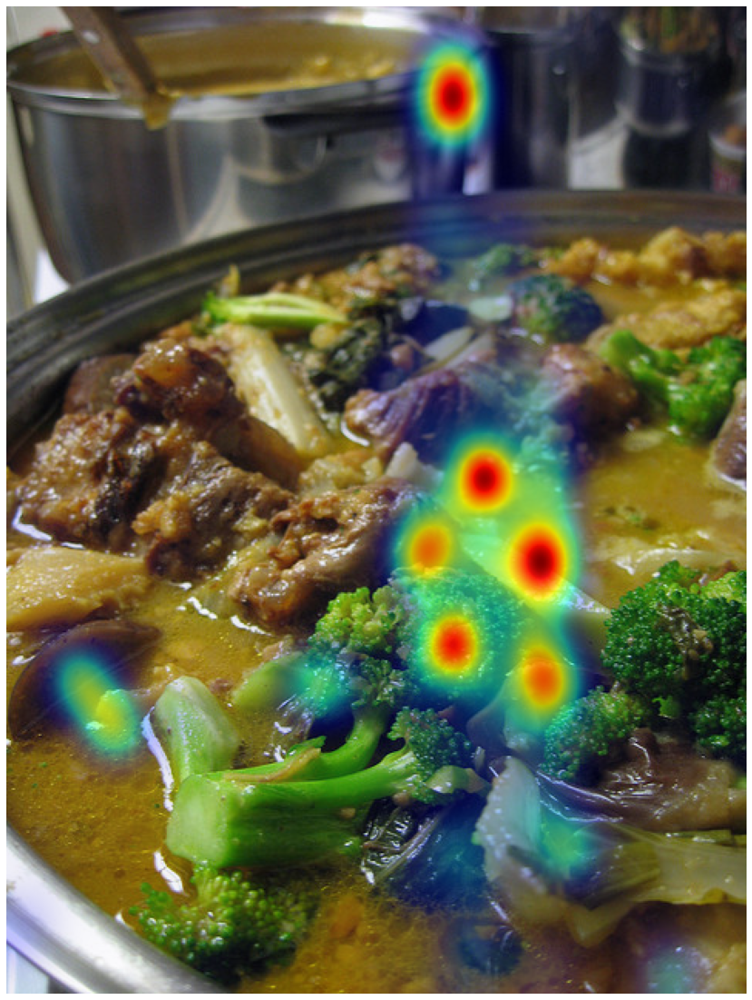

In [146]:

gradcam_image = getAttMap(rgb_image, gradcam[0])
plt.figure(figsize=(20,20))
plt.imshow(gradcam_image)
plt.axis('off')

# 8. Visualize GradCam for each word

In [ ]:
num_image = len(text_vis.input_ids[0]) 
fig, ax = plt.subplots(num_image, 1, figsize=(15,5*num_image))

rgb_image = cv2.imread(image_path)[:, :, ::-1]
rgb_image = np.float32(rgb_image) / 255

print('Visual concepts:', kwords)
ax[0].imshow(rgb_image)
ax[0].set_yticks([])
ax[0].set_xticks([])
ax[0].set_xlabel("Image")
            
for i,token_id in enumerate(text_vis.input_ids[0][1:]):
    word = tokenizer.decode([token_id])
    gradcam_image = getAttMap(rgb_image, gradcam[i+1])
    ax[i+1].imshow(gradcam_image)
    ax[i+1].set_yticks([])
    ax[i+1].set_xticks([])
    ax[i+1].set_xlabel(word, fontsize=16)
    ax[i+1].xaxis.label.set_color('white')

### One run

<ipython-input-6-9aea228aea75>:16: DeprecationWarning: Please use `gaussian_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  attMap = filters.gaussian_filter(attMap, 0.02*max(img.shape[:2]))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Visual concepts: ['broccoli beef', 'beef dish', 'broccoli dish', 'beef stew', 'pork dish', 'broccoli meal', 'asian cuisine', 'vegetables soup', 'thai restaurant', 'meat dish', 'stew', 'meat vegetables', 'broccolli', 'stir fry', 'meat rice']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


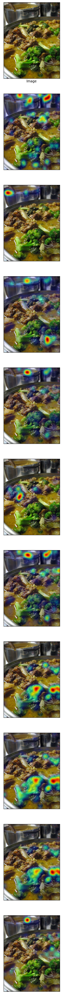

In [67]:
num_kws = None #5
index = 600
kws_indices = None  #[1,2,5] #None


data_dir = '/data/mshukor/data/coco/'
image_path = data_dir + data[index]['image']

image_pil = Image.open(image_path).convert('RGB')   
image = transform(image_pil).unsqueeze(0)  

caption = data[index]['caption'][0]


text = pre_caption(caption)

kwords = data[index]['kwords']

if num_kws is not None:
    kwords = random.choices(kwords, k=num_kws)
elif kws_indices is not None:
    kwords =  [kwords[i] for i in kws_indices]

    
kw = ' '.join(kwords)


# kw = 'woman'
text_input = [tokenizer(text, return_tensors="pt"), tokenizer(kw, return_tensors="pt")]

if use_cuda:
    image = image.cuda()
    text_input = text_input.to(image.device)
    
    
######
output = model(image, text_input)
loss = output[:,1].sum()

model.zero_grad()
loss.backward()    

text_vis = text_input[0]
patch_index = 577
with torch.no_grad():
    mask = text_vis.attention_mask.view(text_vis.attention_mask.size(0),1,-1,1,1)

    grads=model.text_encoder.base_model.base_model.encoder.layer[block_num].crossattention.self.get_attn_gradients()
    cams=model.text_encoder.base_model.base_model.encoder.layer[block_num].crossattention.self.get_attention_map()

    cams = cams[:, :, :, 1:patch_index].reshape(image.size(0), 12, -1, 24, 24) * mask
    grads = grads[:, :, :, 1:patch_index].clamp(0).reshape(image.size(0), 12, -1, 24, 24) * mask

    gradcam = cams * grads
    gradcam = gradcam[0].mean(0).cpu().detach()
    
################
num_image = len(text_vis.input_ids[0]) 
fig, ax = plt.subplots(num_image, 1, figsize=(15,5*num_image))

rgb_image = cv2.imread(image_path)[:, :, ::-1]
rgb_image = np.float32(rgb_image) / 255

print('Visual concepts:', kwords)
ax[0].imshow(rgb_image)
ax[0].set_yticks([])
ax[0].set_xticks([])
ax[0].set_xlabel("Image")
            
for i,token_id in enumerate(text_vis.input_ids[0][1:]):
    word = tokenizer.decode([token_id])
    gradcam_image = getAttMap(rgb_image, gradcam[i+1])
    ax[i+1].imshow(gradcam_image)
    ax[i+1].set_yticks([])
    ax[i+1].set_xticks([])
    ax[i+1].set_xlabel(word, fontsize=16)
    ax[i+1].xaxis.label.set_color('white')

In [ ]:
i = -1
token_id = text_vis.input_ids[0][1:][i]
word = tokenizer.decode([token_id])
print(word)
gradcam_image = getAttMap(rgb_image, gradcam[i+1])
plt.figure(figsize=(20,20))
plt.imshow(gradcam_image)
plt.axis('off')

# ITC GradCAM

In [ ]:
gradcam_mode = 'itc'

In [ ]:
num_kws = 3 #5
index = 600
kws_indices = None  #[1,2,5] #None


data_dir = '/data/mshukor/data/coco/'
image_path = data_dir + data[index]['image']
# image_path = 'examples/image0.jpg'

image_pil = Image.open(image_path).convert('RGB')   
image = transform(image_pil).unsqueeze(0)  

caption = data[index]['caption'][0]
# caption = 'the woman is working on her computer at the desk'


text = pre_caption(caption)
# text_input = tokenizer(text, return_tensors="pt")

kwords = data[index]['kwords']

if num_kws is not None:
    kwords = random.choices(kwords, k=num_kws)
elif kws_indices is not None:
    kwords =  [kwords[i] for i in kws_indices]

    
kw = ' '.join(kwords)


# kw = 'woman'
text_input = [tokenizer(text, return_tensors="pt"), tokenizer(kw, return_tensors="pt")]

if use_cuda:
    image = image.cuda()
    text_input = text_input.to(image.device)
    
    
######


if gradcam_mode=='itm': 
    output = model(image, text_input)
    loss = output[:,1].sum()
elif gradcam_mode=='itc':   
    image_feat, text_feat = model(image, text_input, itc=True)
    sim = image_feat@text_feat.t()/model.temp
    loss = sim.diag().sum()
    


model.zero_grad()
loss.backward()    


text_vis = text_input[0]
patch_index = 577
block_num=-1
feat_map_res = 24
if gradcam_mode=='itc':
    with torch.no_grad():
        grad = model.visual_encoder.blocks[block_num].attn.get_attn_gradients().detach()
        cam = model.visual_encoder.blocks[block_num].attn.get_attention_map().detach()
        cam = cam[:, :, 0, 1:patch_index].reshape(image.size(0), -1, feat_map_res, feat_map_res)
        grad = grad[:, :, 0, 1:patch_index].reshape(image.size(0), -1, feat_map_res, feat_map_res).clamp(0)
        gradcam = (cam * grad).mean(1)
else:
    with torch.no_grad():
        mask = text_vis.attention_mask.view(text_vis.attention_mask.size(0),1,-1,1,1)

        grads=model.text_encoder.base_model.base_model.encoder.layer[block_num].crossattention.self.get_attn_gradients()
        cams=model.text_encoder.base_model.base_model.encoder.layer[block_num].crossattention.self.get_attention_map()

        cams = cams[:, :, :, 1:patch_index].reshape(image.size(0), 12, -1, 24, 24) * mask
        grads = grads[:, :, :, 1:patch_index].clamp(0).reshape(image.size(0), 12, -1, 24, 24) * mask

        gradcam = cams * grads
        gradcam = gradcam[0].mean(0).cpu().detach()
        
        
        
        

    
################
if gradcam_mode=='itc':
    print(kwords)
    rgb_image = cv2.imread(image_path)[:, :, ::-1]
    rgb_image = np.float32(rgb_image) / 255
    
    gradcam_image = getAttMap(rgb_image, gradcam[0])
    plt.figure(figsize=(20,20))
    plt.imshow(gradcam_image)
    plt.axis('off')
else:
    num_image = len(text_vis.input_ids[0]) 
    fig, ax = plt.subplots(num_image, 1, figsize=(15,5*num_image))

    rgb_image = cv2.imread(image_path)[:, :, ::-1]
    rgb_image = np.float32(rgb_image) / 255

    print('Visual concepts:', kwords)
    ax[0].imshow(rgb_image)
    ax[0].set_yticks([])
    ax[0].set_xticks([])
    ax[0].set_xlabel("Image")

    for i,token_id in enumerate(text_vis.input_ids[0][1:]):
        word = tokenizer.decode([token_id])
        gradcam_image = getAttMap(rgb_image, gradcam[i+1])
        ax[i+1].imshow(gradcam_image)
        ax[i+1].set_yticks([])
        ax[i+1].set_xticks([])
        ax[i+1].set_xlabel(word, fontsize=16)
        ax[i+1].xaxis.label.set_color('white')

# VQA

In [91]:
import yaml
import os
import torch
from tqdm import tqdm 

from models.tokenization_bert import BertTokenizer
from dataset import vqa_caption_kw_fuse_collate_fn, create_kw_img_dataset, create_sampler, create_loader, vqa_collate_fn, create_dataset
from models.model_vqa_kw_img import kw_img_ALBEF
from models.vit import interpolate_pos_embed
from models.model_vqa import ALBEF



In [120]:
config_path = '/data/mshukor/logs/vlp_albef/albef_kw_img_aug0_3_vqa_finetune/config.yaml'
config = yaml.load(open(config_path, 'r'), Loader=yaml.Loader)
checkpoint_path = '/data/mshukor/logs/vlp_albef/albef_kw_img_aug0_3_vqa_finetune/checkpoint_last.pth'
data_json_dir = '/data/mshukor/data/our_albef_data/clip_da/data/'


In [121]:
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased', local_files_only=True)

In [122]:

print("Creating dataset")
train_files = []
for p in config['train_file']:
    train_files.append(os.path.join(data_json_dir, p))

config['train_file'] = train_files

test_files = []
for p in config['test_file']:
    test_files.append(os.path.join(data_json_dir, p))

config['test_file'] = test_files

config['answer_list'] = os.path.join(data_json_dir, config['answer_list'])



Creating dataset


In [123]:
data_dir = '/data/mshukor/data'

config['batch_size_test'] = 1
config['vqa_root'] = os.path.join(data_dir, config['vqa_root'])
config['vg_root'] = os.path.join(data_dir, config['vg_root'])

if config.get('kw_img_dataset', False):
    datasets = create_kw_img_dataset('vqa', config, data_dir=data_dir, tokenizer=tokenizer)
    vqa_collate  = vqa_caption_kw_fuse_collate_fn 
else:
    datasets = create_dataset('vqa', config, data_dir=data_dir)
    vqa_collate = vqa_collate_fn

samplers = [None, None]
train_loader, test_loader = create_loader(datasets, samplers,
                                              batch_size=[config['batch_size_train'],config['batch_size_test']],
                                              num_workers=[4,4],is_trains=[True, False], 
                                              collate_fns=[vqa_collate,None]) 

/data/mshukor/data/our_albef_data/clip_da/data/vqa_train.json 443752 443752
/data/mshukor/data/our_albef_data/clip_da/data/vqa_val.json 658104 214352
/data/mshukor/data/our_albef_data/clip_da/data/vqa_test.json 447793 447793


In [124]:
if config.get('kw_img_model', False):
    model = kw_img_ALBEF(config=config, text_encoder='bert-base-uncased', text_decoder='bert-base-uncased', tokenizer=tokenizer)
else:
    model = ALBEF(config=config, text_encoder='bert-base-uncased', text_decoder='bert-base-uncased', tokenizer=tokenizer)

self.kw_img_fusion False
self.kw_only False


In [125]:


checkpoint = torch.load(checkpoint_path, map_location='cpu') 
state_dict = checkpoint['model']

pos_embed_reshaped = interpolate_pos_embed(state_dict['visual_encoder.pos_embed'],model.visual_encoder)         
state_dict['visual_encoder.pos_embed'] = pos_embed_reshaped   

msg = model.load_state_dict(state_dict,strict=False)  
print('load checkpoint from %s'%checkpoint_path)
print(msg)  


load checkpoint from /data/mshukor/logs/vlp_albef/albef_kw_img_aug0_3_vqa_finetune/checkpoint_last.pth
<All keys matched successfully>


In [126]:
model.eval()
device  = torch.device('cpu')
answer_list = [answer+config['eos'] for answer in test_loader.dataset.answer_list]
answer_input = tokenizer(answer_list, padding='longest', return_tensors='pt').to(device)
    
    


In [127]:
def pytorch_to_pil(img):
    max_, min_ = img.max(), img.min()
    x = (img - min_) / (max_ - min_)
    return Image.fromarray((255*x[0]).numpy().astype(np.uint8).transpose(1, 2, 0))

0it [00:00, ?it/s]

{'question_id': 262144000, 'answer': 'yes', 'question': ('is the ball flying towards the batter',), 'VCs': ('fly ball swing position batter swinging mound pitching pitching pose sidearm pitch deck batter pitcher pitches pitcher mound outfielder pitching fielder outfield infielder throwing position',)}


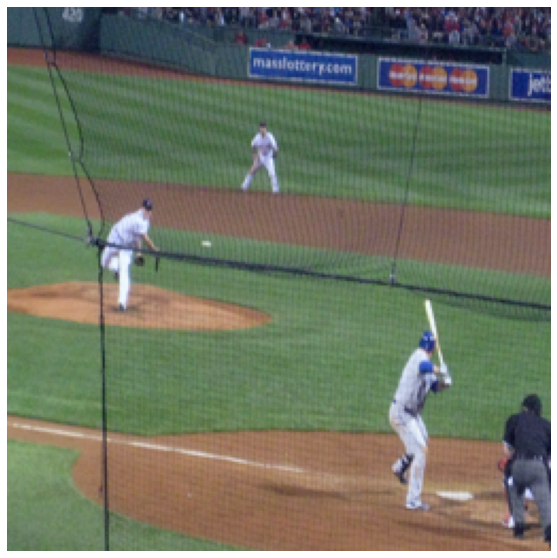

1it [00:06,  6.68s/it]

{'question_id': 262144001, 'answer': 'baseball', 'question': ('what sport is this',), 'VCs': ('fly ball swing position batter swinging mound pitching pitching pose sidearm pitch deck batter pitcher pitches pitcher mound outfielder pitching fielder outfield infielder throwing position',)}


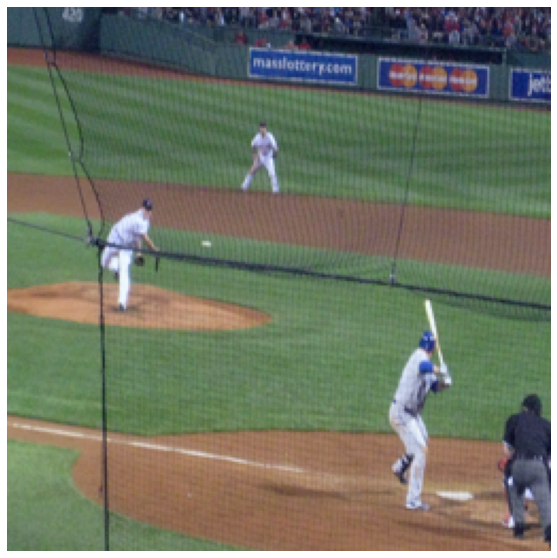

2it [00:12,  6.34s/it]

{'question_id': 262144002, 'answer': 'yes', 'question': ('can you see the ball',), 'VCs': ('fly ball swing position batter swinging mound pitching pitching pose sidearm pitch deck batter pitcher pitches pitcher mound outfielder pitching fielder outfield infielder throwing position',)}


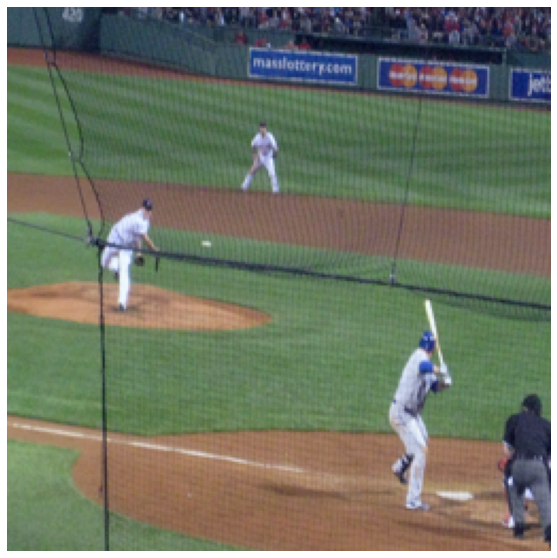

3it [00:18,  5.97s/it]

{'question_id': 262144003, 'answer': 'yes', 'question': ('is the pitcher wearing a hat',), 'VCs': ('fly ball swing position batter swinging mound pitching pitching pose sidearm pitch deck batter pitcher pitches pitcher mound outfielder pitching fielder outfield infielder throwing position',)}


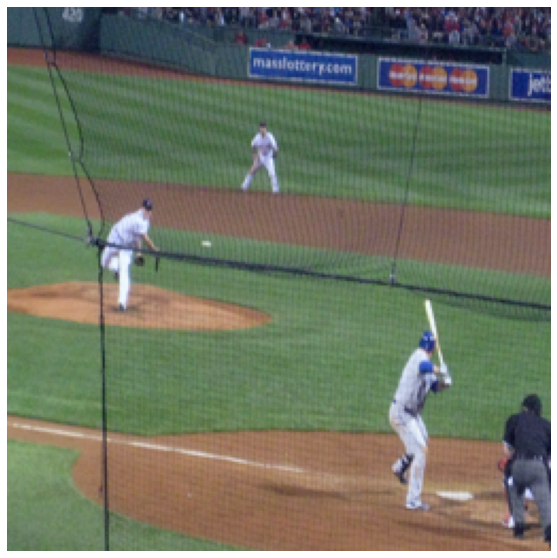

4it [00:23,  5.78s/it]

{'question_id': 262144004, 'answer': 'yes', 'question': ('will he catch the ball in time',), 'VCs': ('fly ball swing position batter swinging mound pitching pitching pose sidearm pitch deck batter pitcher pitches pitcher mound outfielder pitching fielder outfield infielder throwing position',)}


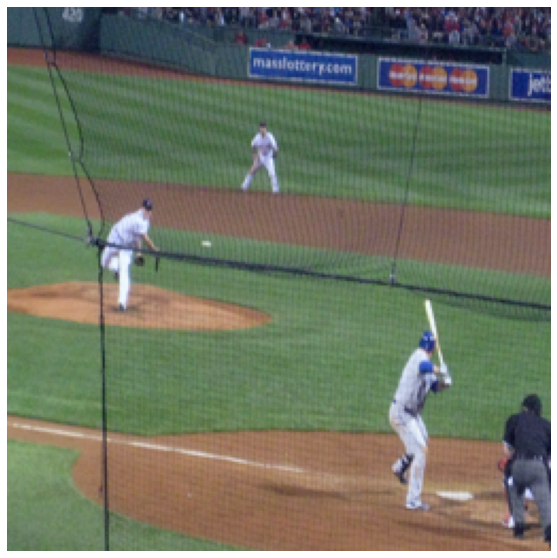

5it [00:29,  5.70s/it]

{'question_id': 262144005, 'answer': 'american', 'question': ('what credit card company is on the banner in the background',), 'VCs': ('fly ball swing position batter swinging mound pitching pitching pose sidearm pitch deck batter pitcher pitches pitcher mound outfielder pitching fielder outfield infielder throwing position',)}


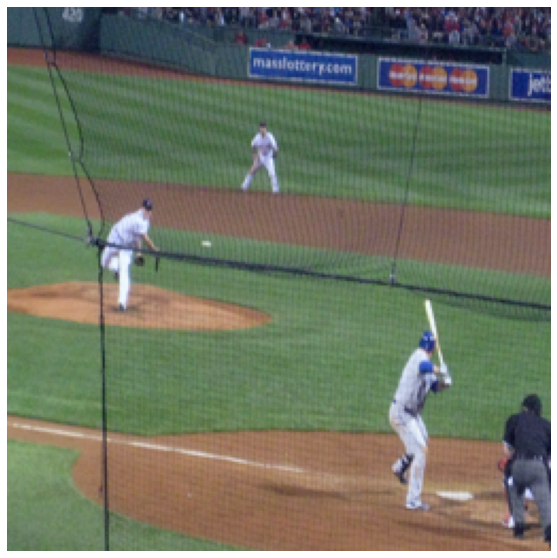

6it [00:35,  5.74s/it]

{'question_id': 1000, 'answer': 'metal', 'question': ('what is the fence made of',), 'VCs': ('patrol truck park police patrol car guard truck tow truck utility truck police truck towtruck tow trucks utility trucks garbage collectors parking meter service truck taxi van street cleaner',)}


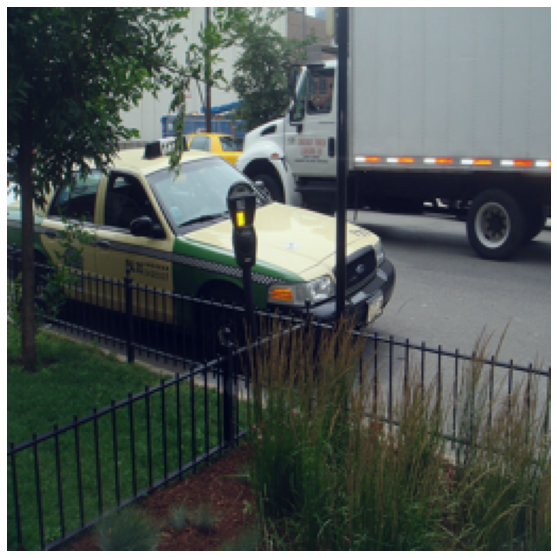

7it [00:40,  5.74s/it]

{'question_id': 1001, 'answer': 'white', 'question': ('what color is the truck',), 'VCs': ('patrol truck park police patrol car guard truck tow truck utility truck police truck towtruck tow trucks utility trucks garbage collectors parking meter service truck taxi van street cleaner',)}


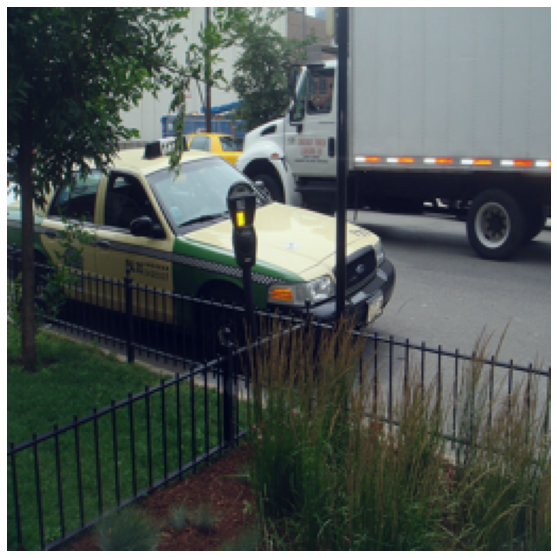

8it [00:46,  5.69s/it]

{'question_id': 1002, 'answer': 'police', 'question': ('what service does the car parked at the curb provide',), 'VCs': ('patrol truck park police patrol car guard truck tow truck utility truck police truck towtruck tow trucks utility trucks garbage collectors parking meter service truck taxi van street cleaner',)}


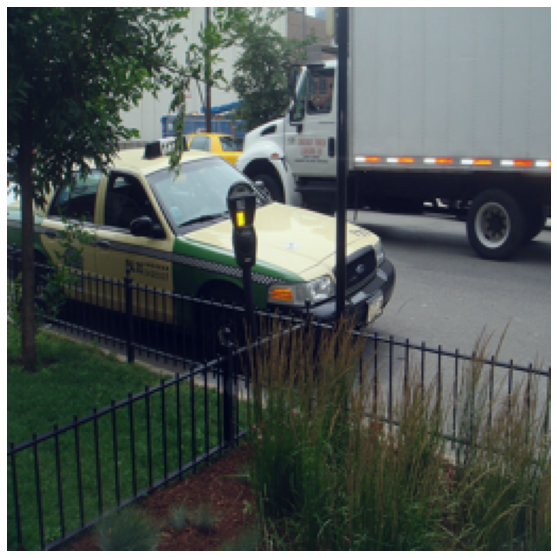

9it [00:52,  5.69s/it]

{'question_id': 524292000, 'answer': 'food', 'question': ('what function is served by the item the giraffe is peering into',), 'VCs': ('adult zebras couple zebras zoo paddock giraffe towers wildlife park giraffe peers zebras grazing giraffs adult giraffes city zoo baby zebras zoo graze standing zebra side girafes zebras grazes',)}


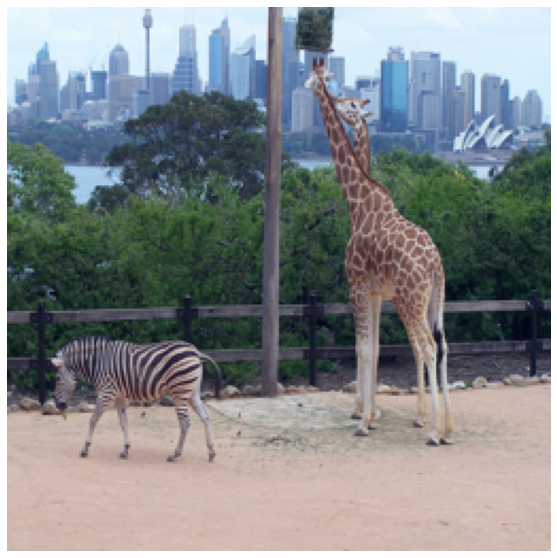

10it [00:58,  5.76s/it]

{'question_id': 524292001, 'answer': 'no', 'question': ('is this in australia',), 'VCs': ('adult zebras couple zebras zoo paddock giraffe towers wildlife park giraffe peers zebras grazing giraffs adult giraffes city zoo baby zebras zoo graze standing zebra side girafes zebras grazes',)}


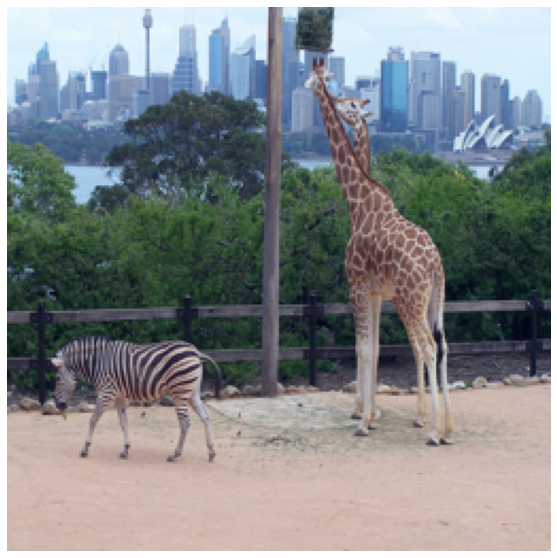

11it [01:03,  5.70s/it]

{'question_id': 524292002, 'answer': 'no', 'question': ('are the giraffes playing basketball',), 'VCs': ('adult zebras couple zebras zoo paddock giraffe towers wildlife park giraffe peers zebras grazing giraffs adult giraffes city zoo baby zebras zoo graze standing zebra side girafes zebras grazes',)}


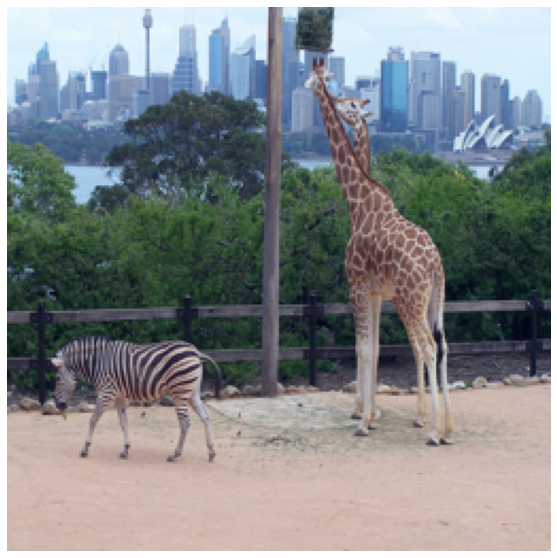

12it [01:09,  5.74s/it]

{'question_id': 524292003, 'answer': 'no', 'question': ('are the trees taller than the giraffes',), 'VCs': ('adult zebras couple zebras zoo paddock giraffe towers wildlife park giraffe peers zebras grazing giraffs adult giraffes city zoo baby zebras zoo graze standing zebra side girafes zebras grazes',)}


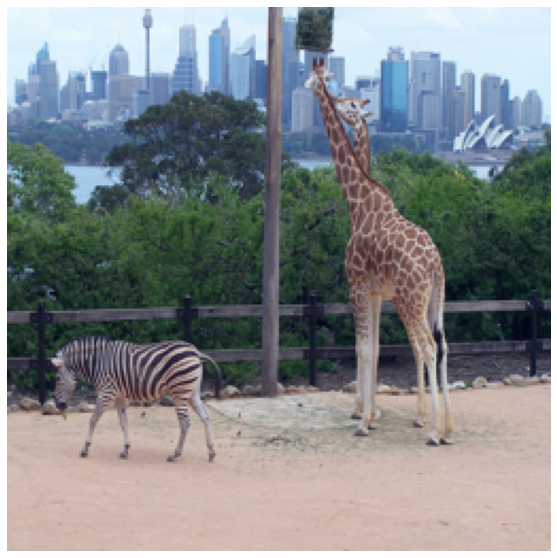

13it [01:15,  5.80s/it]

{'question_id': 524292004, 'answer': 'yes', 'question': ('is there any fence in front of zebra',), 'VCs': ('adult zebras couple zebras zoo paddock giraffe towers wildlife park giraffe peers zebras grazing giraffs adult giraffes city zoo baby zebras zoo graze standing zebra side girafes zebras grazes',)}


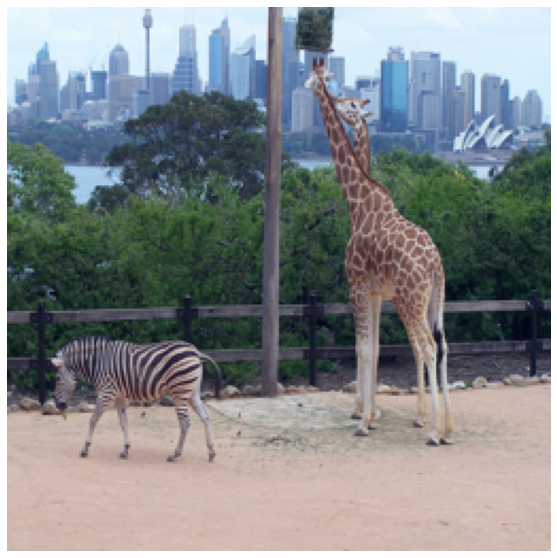

14it [01:21,  5.78s/it]

{'question_id': 131079000, 'answer': 'yes', 'question': ('is it raining',), 'VCs': ('landing runway water runway airport landing landing plane airliner landing ana airplane landing airport runway skyteam airplane plane landing force one landing airport area airplane landing takeoff airliners',)}


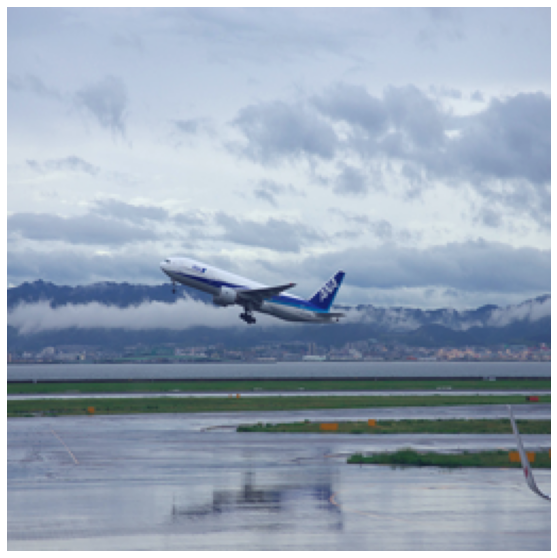

15it [01:26,  5.67s/it]

{'question_id': 131079001, 'answer': 'yes', 'question': ('is the landing gear down',), 'VCs': ('landing runway water runway airport landing landing plane airliner landing ana airplane landing airport runway skyteam airplane plane landing force one landing airport area airplane landing takeoff airliners',)}


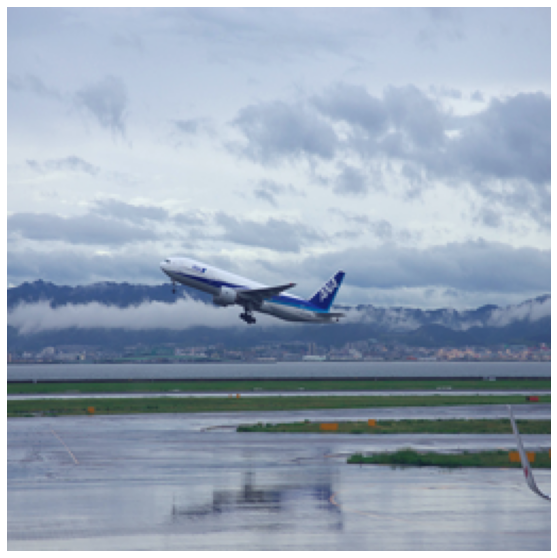

16it [01:32,  5.61s/it]

{'question_id': 131079002, 'answer': 'taking off', 'question': ('is this airplane taking off or landing',), 'VCs': ('landing runway water runway airport landing landing plane airliner landing ana airplane landing airport runway skyteam airplane plane landing force one landing airport area airplane landing takeoff airliners',)}


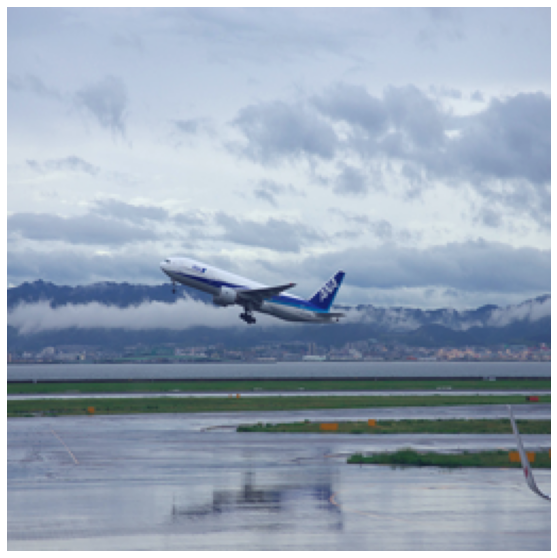

17it [01:37,  5.60s/it]

{'question_id': 131083000, 'answer': 'steps', 'question': ('what is she sitting on',), 'VCs': ('woman crouches airport scene waiting station station people airport worker woman grimaces subway platform bus station person bench airport attendants person view passersby mobile phone woman pointing station bench',)}


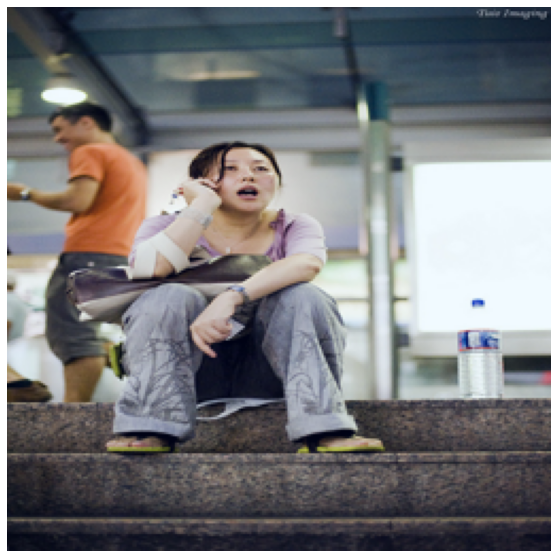

18it [01:43,  5.58s/it]

{'question_id': 131083001, 'answer': 'no', 'question': ('is that a smartphone she is holding',), 'VCs': ('woman crouches airport scene waiting station station people airport worker woman grimaces subway platform bus station person bench airport attendants person view passersby mobile phone woman pointing station bench',)}


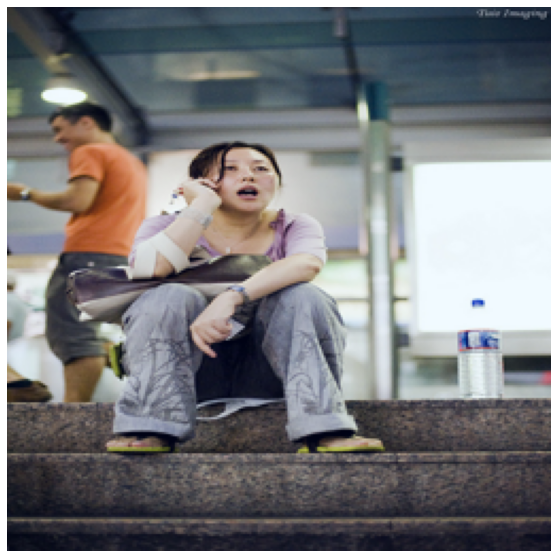

19it [01:48,  5.59s/it]

{'question_id': 131083002, 'answer': 'bracelet', 'question': ('what type of garment or accessory is being worn by both people',), 'VCs': ('woman crouches airport scene waiting station station people airport worker woman grimaces subway platform bus station person bench airport attendants person view passersby mobile phone woman pointing station bench',)}


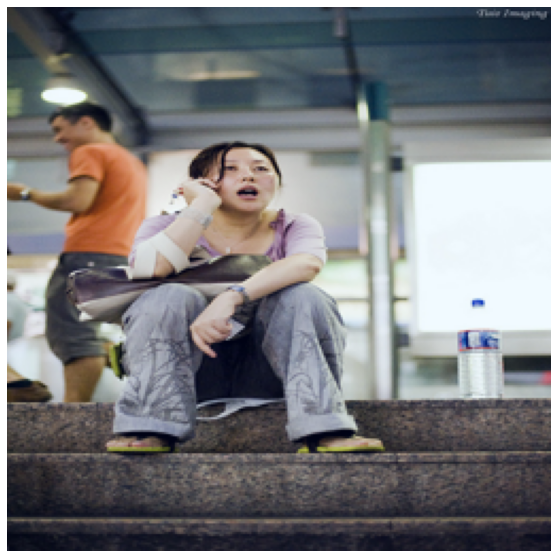

20it [01:54,  5.68s/it]

{'question_id': 131083003, 'answer': 'talking on phone', 'question': ('what is the woman doing',), 'VCs': ('woman crouches airport scene waiting station station people airport worker woman grimaces subway platform bus station person bench airport attendants person view passersby mobile phone woman pointing station bench',)}


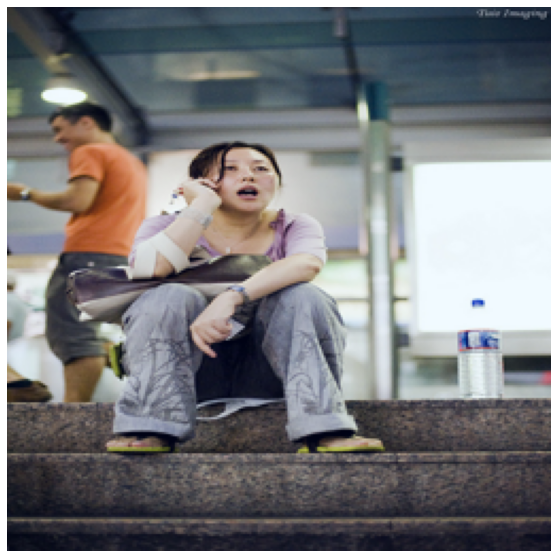

21it [02:00,  5.65s/it]

{'question_id': 131083004, 'answer': 'brown', 'question': ('what color is her hair',), 'VCs': ('woman crouches airport scene waiting station station people airport worker woman grimaces subway platform bus station person bench airport attendants person view passersby mobile phone woman pointing station bench',)}


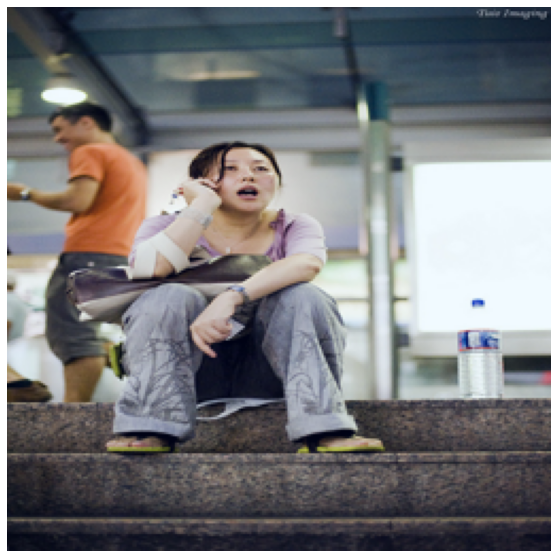

22it [02:05,  5.62s/it]

{'question_id': 131083005, 'answer': 'hair', 'question': ('what is on the womans head',), 'VCs': ('woman crouches airport scene waiting station station people airport worker woman grimaces subway platform bus station person bench airport attendants person view passersby mobile phone woman pointing station bench',)}


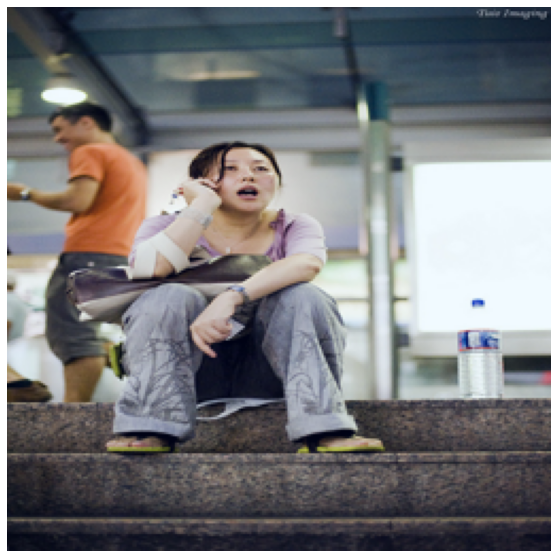

23it [02:11,  5.62s/it]

{'question_id': 131083006, 'answer': 'jeans', 'question': ('what kind of pants is the woman wearing',), 'VCs': ('woman crouches airport scene waiting station station people airport worker woman grimaces subway platform bus station person bench airport attendants person view passersby mobile phone woman pointing station bench',)}


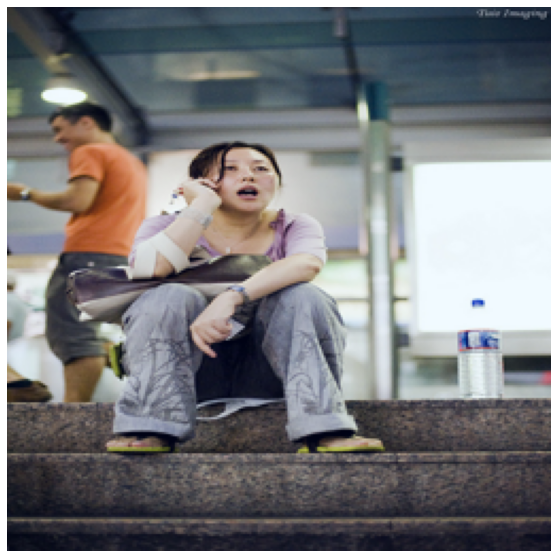

24it [02:17,  5.64s/it]

{'question_id': 131083007, 'answer': 'no', 'question': ('is there an plate',), 'VCs': ('woman crouches airport scene waiting station station people airport worker woman grimaces subway platform bus station person bench airport attendants person view passersby mobile phone woman pointing station bench',)}


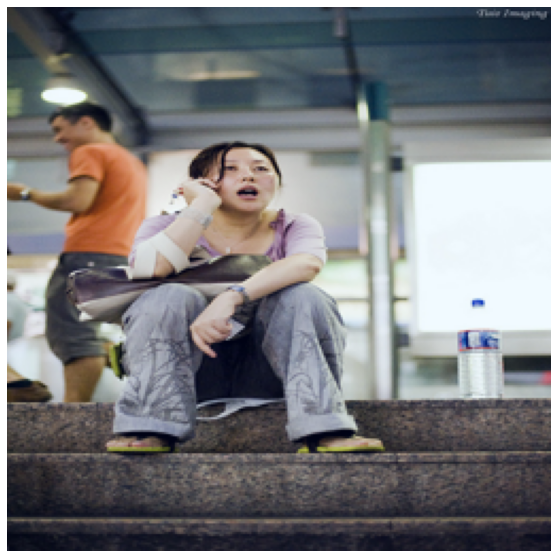

25it [02:22,  5.60s/it]

{'question_id': 131083008, 'answer': 'no', 'question': ('do both women carry handbags',), 'VCs': ('woman crouches airport scene waiting station station people airport worker woman grimaces subway platform bus station person bench airport attendants person view passersby mobile phone woman pointing station bench',)}


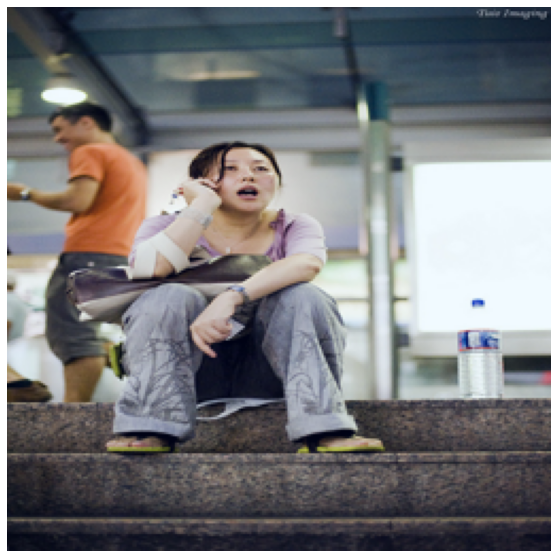

26it [02:28,  5.61s/it]

{'question_id': 131083009, 'answer': 'no', 'question': ('is there anyone wearing a hat',), 'VCs': ('woman crouches airport scene waiting station station people airport worker woman grimaces subway platform bus station person bench airport attendants person view passersby mobile phone woman pointing station bench',)}


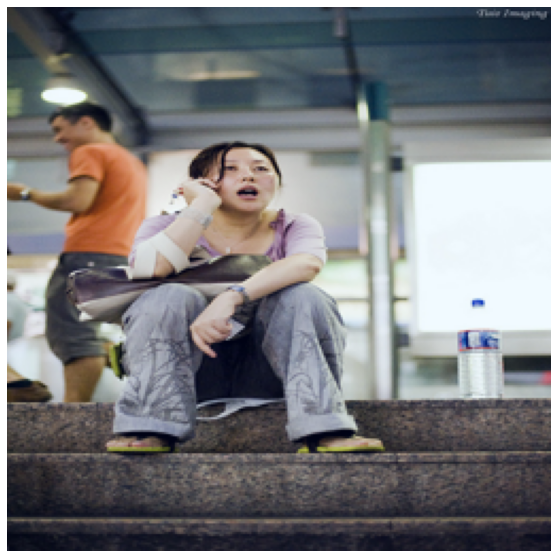

27it [02:33,  5.61s/it]

{'question_id': 131083010, 'answer': '2', 'question': ('how many steps',), 'VCs': ('woman crouches airport scene waiting station station people airport worker woman grimaces subway platform bus station person bench airport attendants person view passersby mobile phone woman pointing station bench',)}


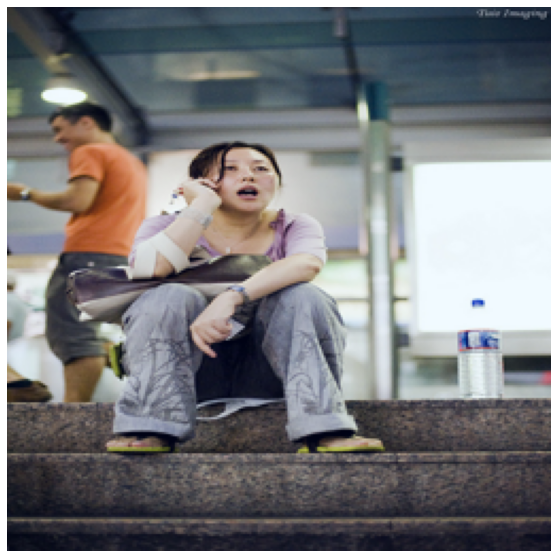

28it [02:39,  5.57s/it]

{'question_id': 131083011, 'answer': '2', 'question': ('how many people are sitting down',), 'VCs': ('woman crouches airport scene waiting station station people airport worker woman grimaces subway platform bus station person bench airport attendants person view passersby mobile phone woman pointing station bench',)}


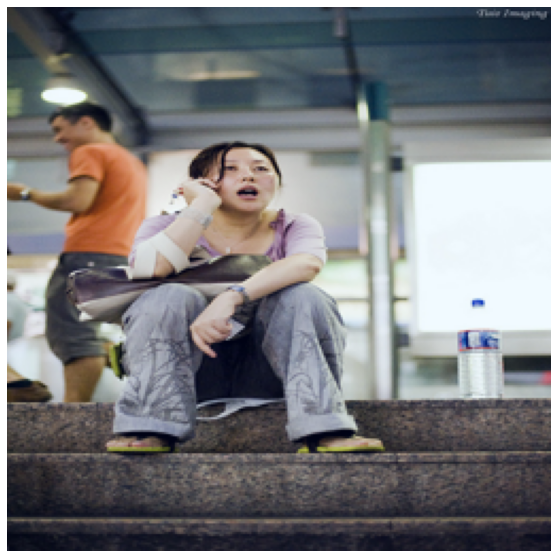

29it [02:44,  5.56s/it]

{'question_id': 131083012, 'answer': 'yes', 'question': ('is the girls mouth closed',), 'VCs': ('woman crouches airport scene waiting station station people airport worker woman grimaces subway platform bus station person bench airport attendants person view passersby mobile phone woman pointing station bench',)}


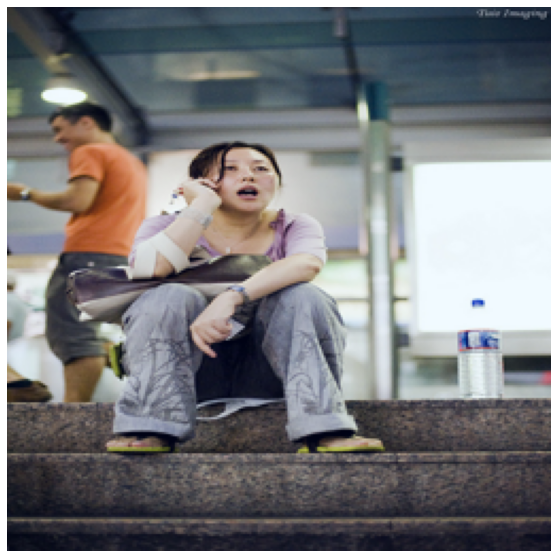

30it [02:50,  5.53s/it]

{'question_id': 131083013, 'answer': 'no', 'question': ('does the woman have sexy legs',), 'VCs': ('woman crouches airport scene waiting station station people airport worker woman grimaces subway platform bus station person bench airport attendants person view passersby mobile phone woman pointing station bench',)}


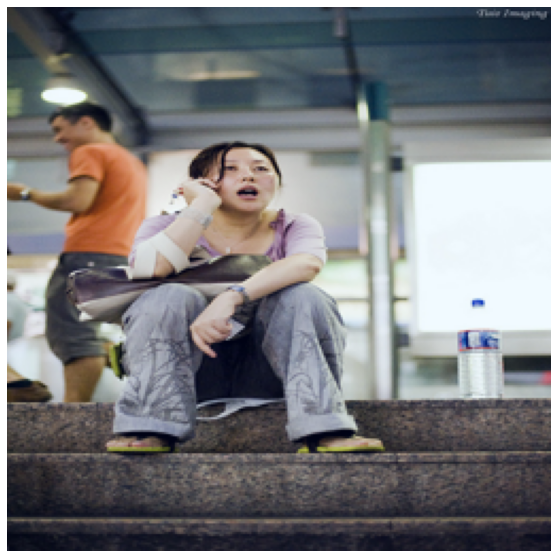

31it [02:55,  5.56s/it]

{'question_id': 131083014, 'answer': 'steps', 'question': ('where is the woman sitting',), 'VCs': ('woman crouches airport scene waiting station station people airport worker woman grimaces subway platform bus station person bench airport attendants person view passersby mobile phone woman pointing station bench',)}


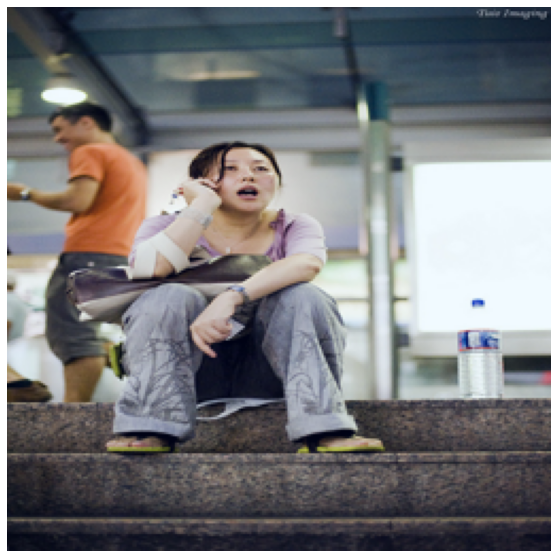

32it [03:01,  5.54s/it]

{'question_id': 524301000, 'answer': 'gray and white', 'question': ('what color is the cat',), 'VCs': ('food dish feeding dish food bowl cat food dinner plate feeding bowls filmstrip motion blur paper plate food tray food plate dinner tray leftover food motion photo glass pan',)}


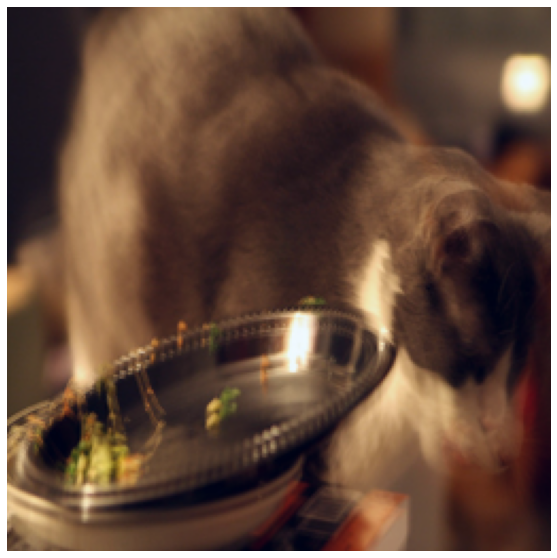

33it [03:06,  5.53s/it]

{'question_id': 524301001, 'answer': 'yes', 'question': ('is there any light visible on top of the cat',), 'VCs': ('food dish feeding dish food bowl cat food dinner plate feeding bowls filmstrip motion blur paper plate food tray food plate dinner tray leftover food motion photo glass pan',)}


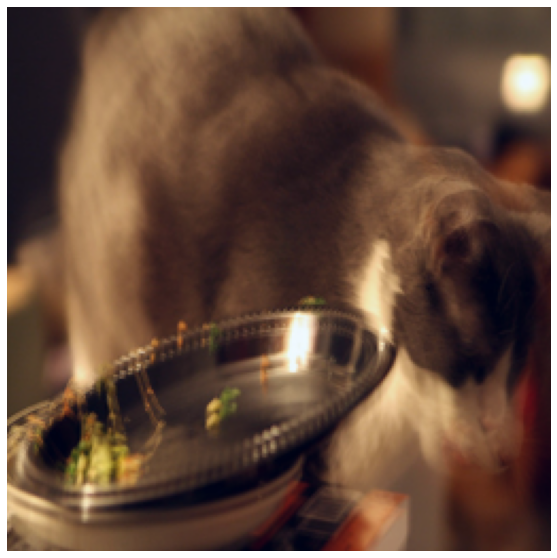

34it [03:12,  5.61s/it]

{'question_id': 524301002, 'answer': 'yes', 'question': ('did the cat eat the food on the plate',), 'VCs': ('food dish feeding dish food bowl cat food dinner plate feeding bowls filmstrip motion blur paper plate food tray food plate dinner tray leftover food motion photo glass pan',)}


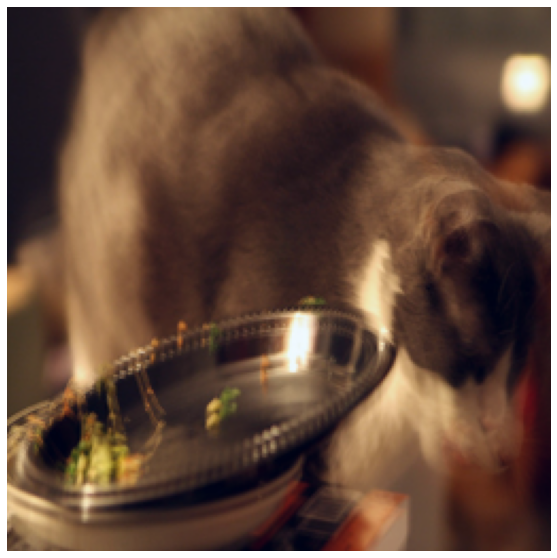

35it [03:18,  5.64s/it]

{'question_id': 14000, 'answer': 'white', 'question': ('what color is the persons helmet',), 'VCs': ('town moto motorcycles parked street traffic street image motorcycles line motorcycle riders street parking street directions street setting type motorcycle helmet skateboards mopeds motorcycle parade locale parking motorcycle lot',)}


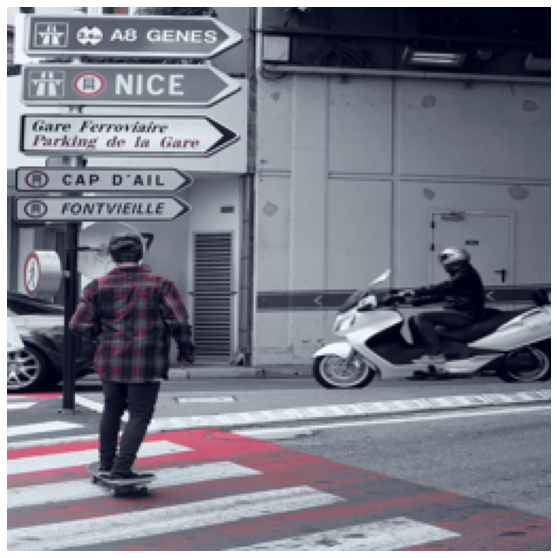

36it [03:24,  5.62s/it]

{'question_id': 131090005, 'answer': 'no', 'question': ('is there hand soap on the sink',), 'VCs': ('toilet area style toilet toilet cubicle bathroom toilet bathroom image bathroom area toilet room size bathroom toilets side utility bathroom grey bathroom bathroom cubicle retro bathroom mens bathroom metal bathroom',)}


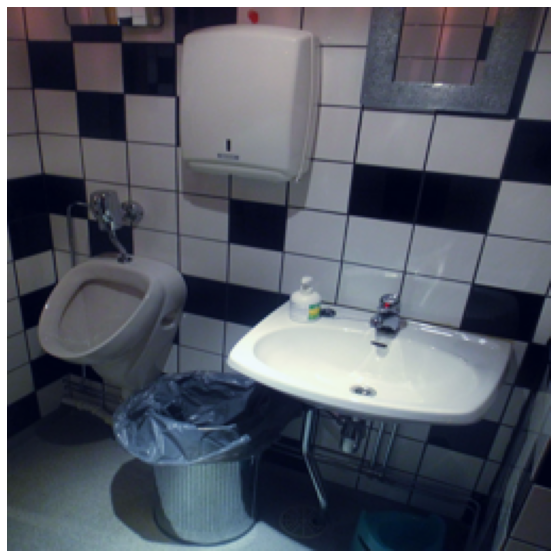

55it [05:11,  5.76s/it]

{'question_id': 131090006, 'answer': 'left', 'question': ('which one do you pee in',), 'VCs': ('toilet area style toilet toilet cubicle bathroom toilet bathroom image bathroom area toilet room size bathroom toilets side utility bathroom grey bathroom bathroom cubicle retro bathroom mens bathroom metal bathroom',)}


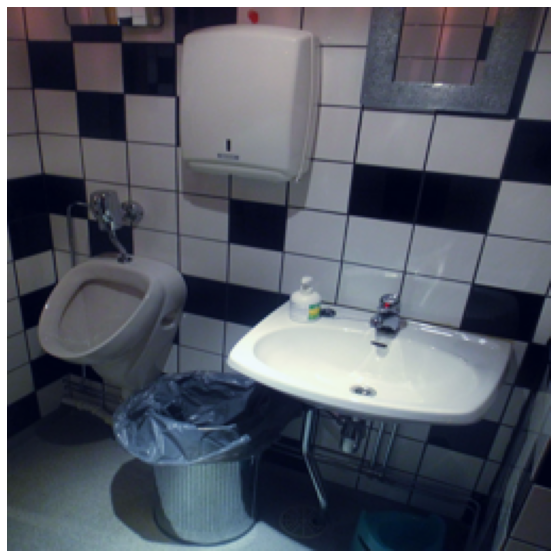

56it [05:17,  5.72s/it]

{'question_id': 131090007, 'answer': 'white', 'question': ('what color is the bottle on the sink',), 'VCs': ('toilet area style toilet toilet cubicle bathroom toilet bathroom image bathroom area toilet room size bathroom toilets side utility bathroom grey bathroom bathroom cubicle retro bathroom mens bathroom metal bathroom',)}


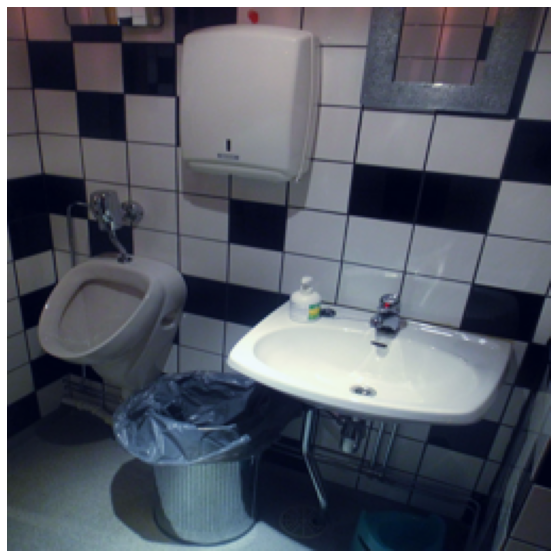

57it [05:22,  5.73s/it]

{'question_id': 131090008, 'answer': '0', 'question': ('how many bottle of soap are displayed',), 'VCs': ('toilet area style toilet toilet cubicle bathroom toilet bathroom image bathroom area toilet room size bathroom toilets side utility bathroom grey bathroom bathroom cubicle retro bathroom mens bathroom metal bathroom',)}


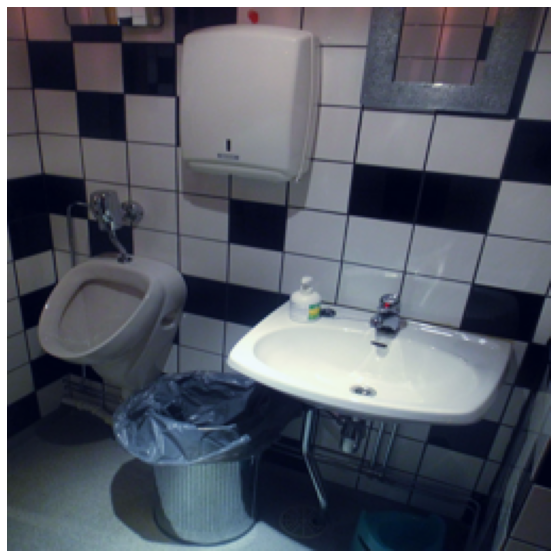

58it [05:28,  5.71s/it]

{'question_id': 131090009, 'answer': 'no', 'question': ('is there a towel rack visible',), 'VCs': ('toilet area style toilet toilet cubicle bathroom toilet bathroom image bathroom area toilet room size bathroom toilets side utility bathroom grey bathroom bathroom cubicle retro bathroom mens bathroom metal bathroom',)}


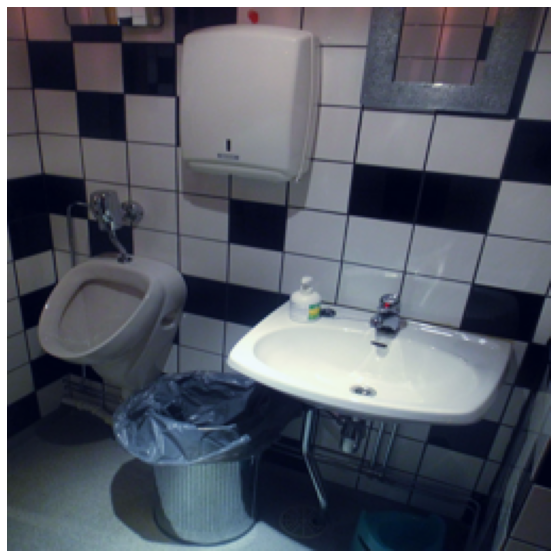

59it [05:34,  5.69s/it]

{'question_id': 131091000, 'answer': 'no', 'question': ('would you be afraid of getting mugged here',), 'VCs': ('motorola building downtown chicago chicago metropolis city photo business district style buildings bay street wall street people buildings office buildings park avenue wall st. landmarks buildings',)}


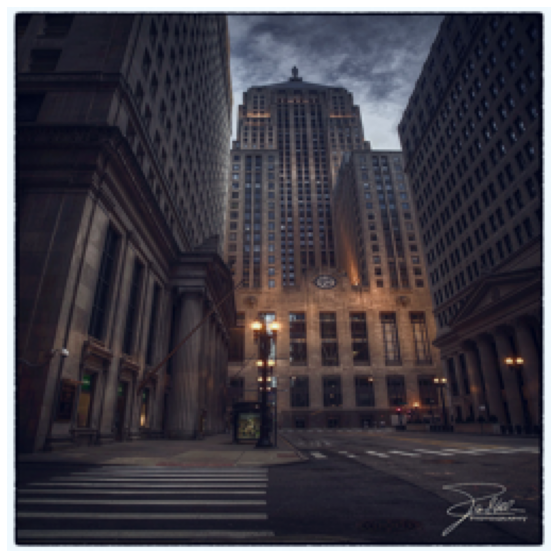

60it [05:40,  5.72s/it]

{'question_id': 131091001, 'answer': 'no', 'question': ('is it sunny out',), 'VCs': ('motorola building downtown chicago chicago metropolis city photo business district style buildings bay street wall street people buildings office buildings park avenue wall st. landmarks buildings',)}


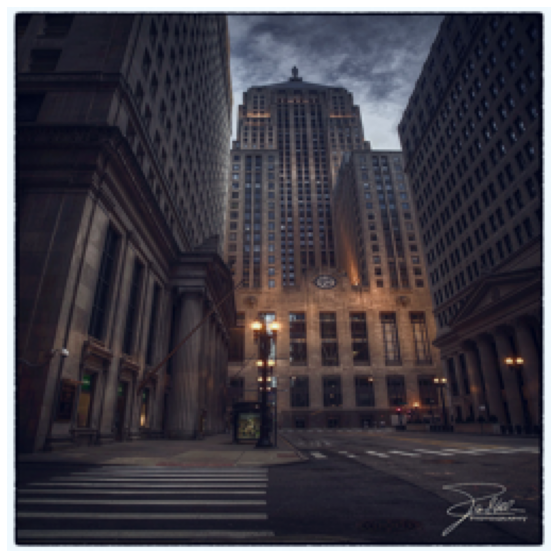

61it [05:45,  5.66s/it]

{'question_id': 131091002, 'answer': 'yes', 'question': ('is there lighting',), 'VCs': ('motorola building downtown chicago chicago metropolis city photo business district style buildings bay street wall street people buildings office buildings park avenue wall st. landmarks buildings',)}


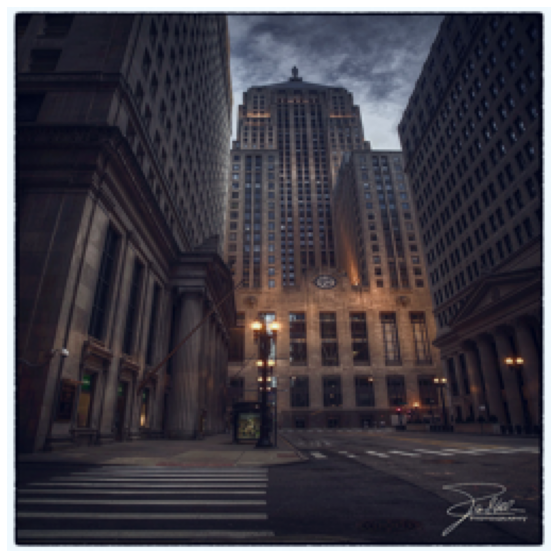

62it [05:51,  5.60s/it]

{'question_id': 262164000, 'answer': 'no', 'question': ('does the giraffe appear dangerous',), 'VCs': ('giraffe nibbling giraffe leans adult giraffe giraffe eat giraffe enclosure drinking giraffe water zoo keeper giraffe munching giraffe forages giraffe peers giraffe reaches giraffe stares zookeeper giraffes lounge wildlife park',)}


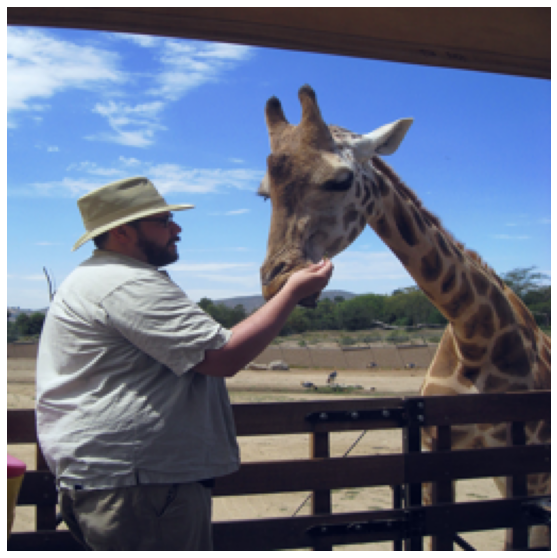

63it [05:56,  5.66s/it]

{'question_id': 262164001, 'answer': 'white', 'question': ('what color is the mans shirt',), 'VCs': ('giraffe nibbling giraffe leans adult giraffe giraffe eat giraffe enclosure drinking giraffe water zoo keeper giraffe munching giraffe forages giraffe peers giraffe reaches giraffe stares zookeeper giraffes lounge wildlife park',)}


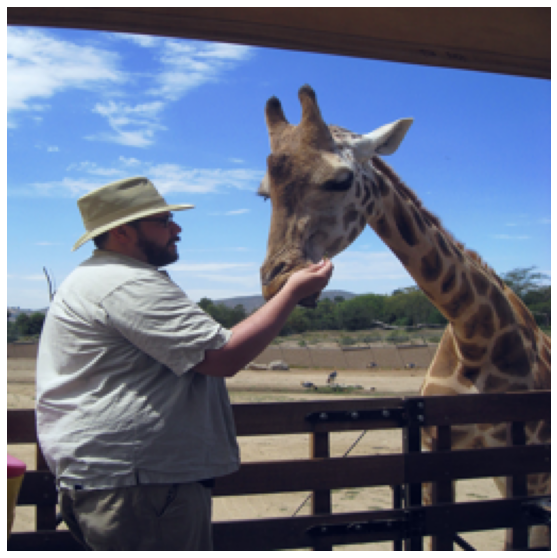

64it [06:02,  5.68s/it]

{'question_id': 262164002, 'answer': 'giraffe', 'question': ('what animal is this',), 'VCs': ('giraffe nibbling giraffe leans adult giraffe giraffe eat giraffe enclosure drinking giraffe water zoo keeper giraffe munching giraffe forages giraffe peers giraffe reaches giraffe stares zookeeper giraffes lounge wildlife park',)}


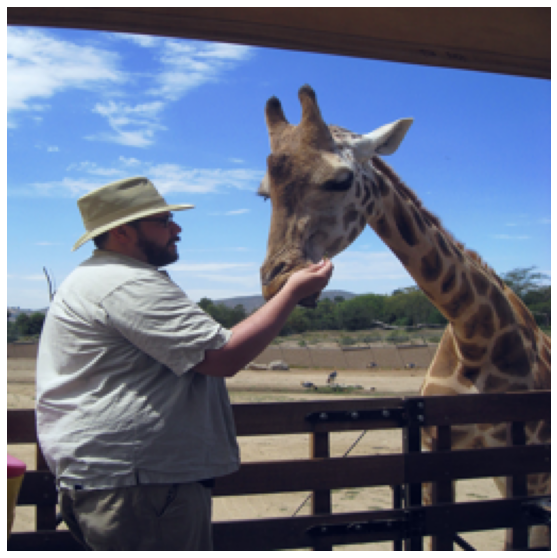

65it [06:08,  5.67s/it]

{'question_id': 262164003, 'answer': 'brown', 'question': ('what color are the spots on the animal',), 'VCs': ('giraffe nibbling giraffe leans adult giraffe giraffe eat giraffe enclosure drinking giraffe water zoo keeper giraffe munching giraffe forages giraffe peers giraffe reaches giraffe stares zookeeper giraffes lounge wildlife park',)}


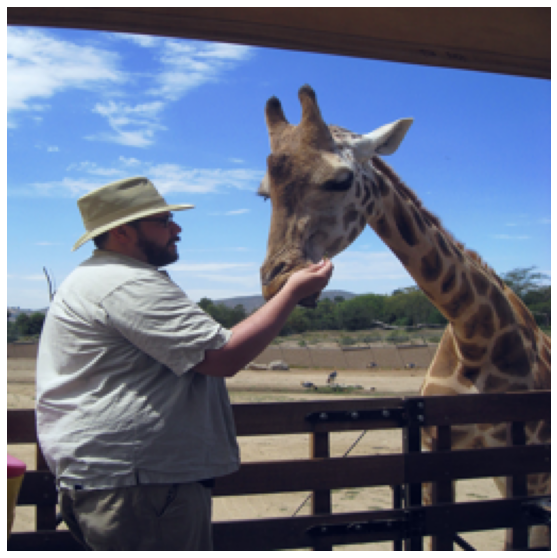

66it [06:14,  5.71s/it]

{'question_id': 262164004, 'answer': 'no', 'question': ('is the man wearing sunglasses',), 'VCs': ('giraffe nibbling giraffe leans adult giraffe giraffe eat giraffe enclosure drinking giraffe water zoo keeper giraffe munching giraffe forages giraffe peers giraffe reaches giraffe stares zookeeper giraffes lounge wildlife park',)}


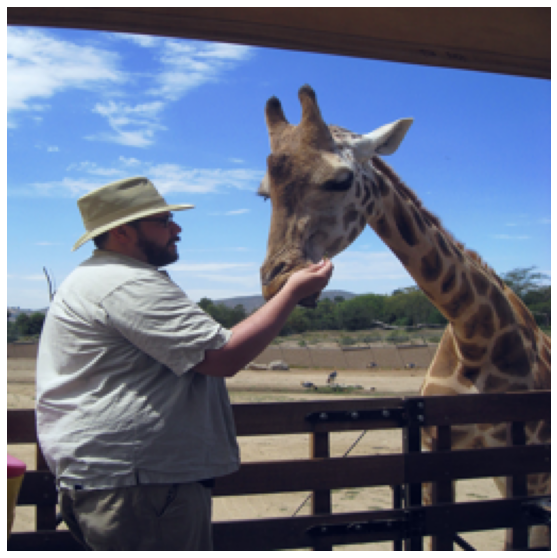

67it [06:19,  5.68s/it]

{'question_id': 393238000, 'answer': 'baseball', 'question': ('what sport is this',), 'VCs': ('batting cages baseball youth player playing baseball baseball youth team batting stance batting batting practice person batting action batting baseball batter baseball practice batting cage baseball outfielder batter swinging baseball fielder',)}


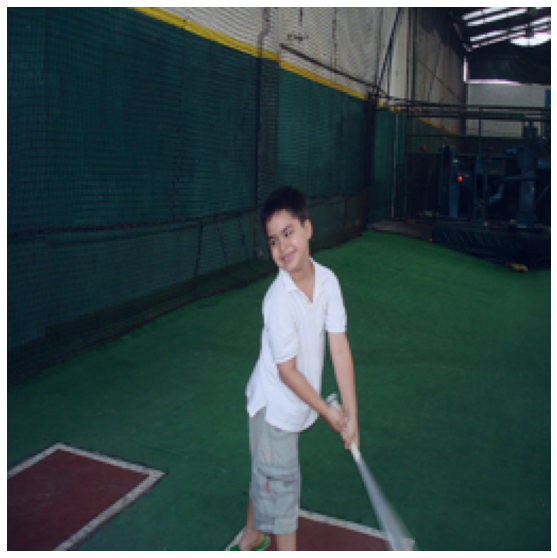

68it [06:25,  5.59s/it]

{'question_id': 393238001, 'answer': 'yes', 'question': ('is this picture in color',), 'VCs': ('batting cages baseball youth player playing baseball baseball youth team batting stance batting batting practice person batting action batting baseball batter baseball practice batting cage baseball outfielder batter swinging baseball fielder',)}


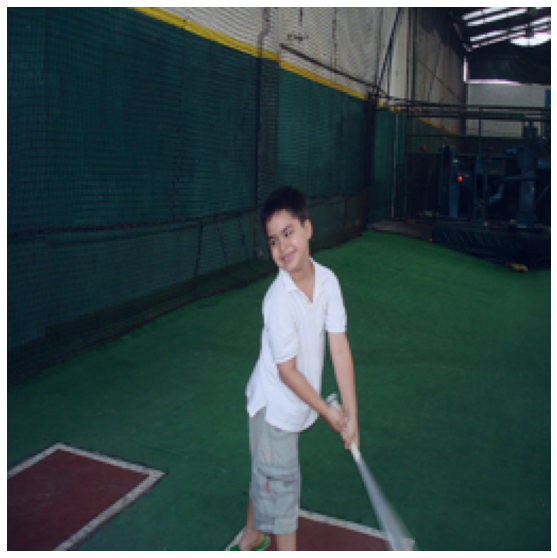

69it [06:30,  5.57s/it]

{'question_id': 393238002, 'answer': 'baseball field', 'question': ('what do you call this sports location',), 'VCs': ('batting cages baseball youth player playing baseball baseball youth team batting stance batting batting practice person batting action batting baseball batter baseball practice batting cage baseball outfielder batter swinging baseball fielder',)}


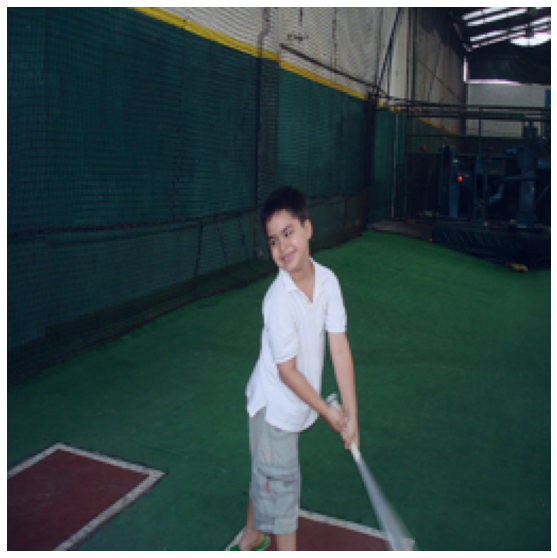

70it [06:36,  5.59s/it]

{'question_id': 393238003, 'answer': 'baseball field', 'question': ('where is he standing',), 'VCs': ('batting cages baseball youth player playing baseball baseball youth team batting stance batting batting practice person batting action batting baseball batter baseball practice batting cage baseball outfielder batter swinging baseball fielder',)}


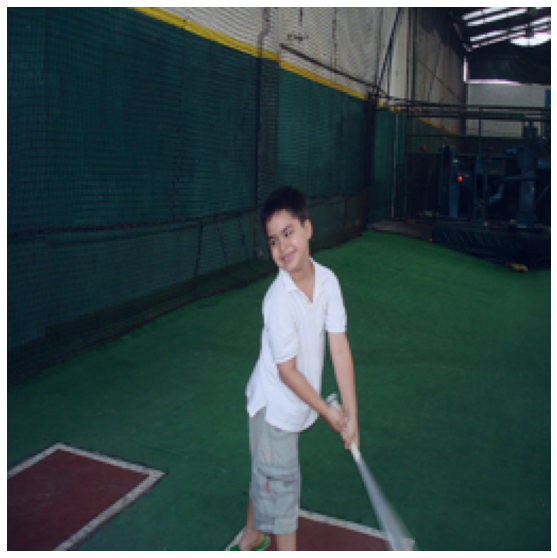

71it [06:41,  5.55s/it]

{'question_id': 393238004, 'answer': 'baseball', 'question': ('what is the name of this sport',), 'VCs': ('batting cages baseball youth player playing baseball baseball youth team batting stance batting batting practice person batting action batting baseball batter baseball practice batting cage baseball outfielder batter swinging baseball fielder',)}


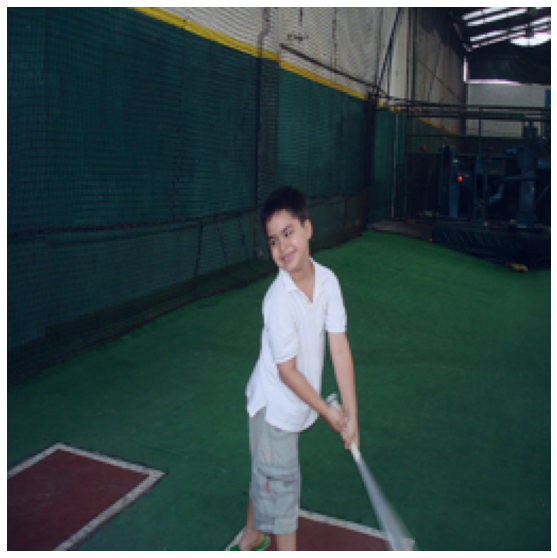

72it [06:47,  5.57s/it]

{'question_id': 393238005, 'answer': 't shirt', 'question': ('what is the boy wearing',), 'VCs': ('batting cages baseball youth player playing baseball baseball youth team batting stance batting batting practice person batting action batting baseball batter baseball practice batting cage baseball outfielder batter swinging baseball fielder',)}


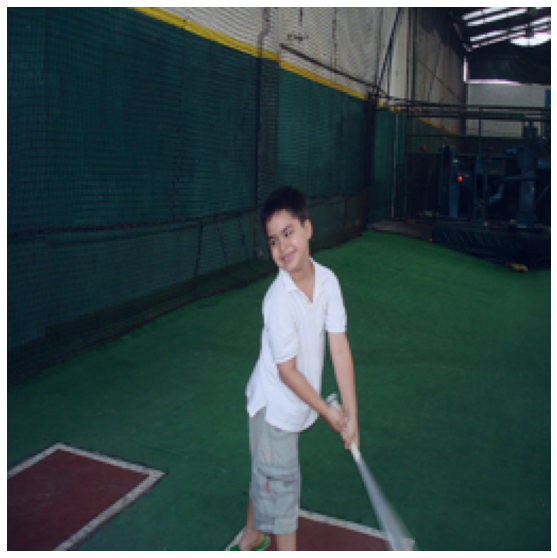

73it [06:52,  5.55s/it]

{'question_id': 393238006, 'answer': 'baseball', 'question': ('what sport are they playing',), 'VCs': ('batting cages baseball youth player playing baseball baseball youth team batting stance batting batting practice person batting action batting baseball batter baseball practice batting cage baseball outfielder batter swinging baseball fielder',)}


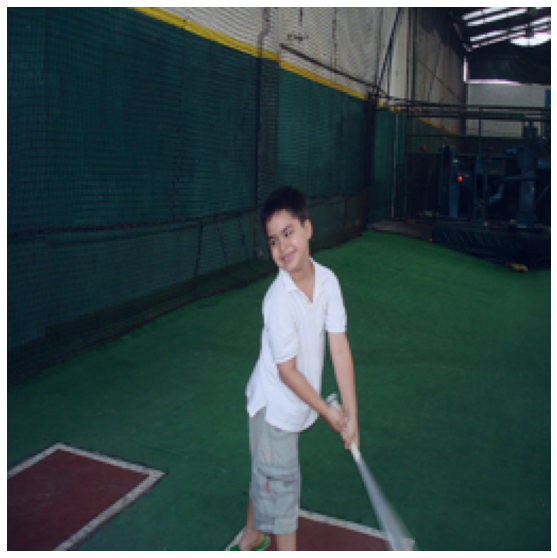

74it [06:58,  5.53s/it]

{'question_id': 262169000, 'answer': 'no', 'question': ('is that a steer skull in the background',), 'VCs': ('elephant exhibit zoo elephant adult elephants elephant enclosure elephant playing adult elephant zoo exhibit elephant trunk bull elephants elephant park group elephants zoo fence circus elephants elephants trunk wildlife exhibit',)}


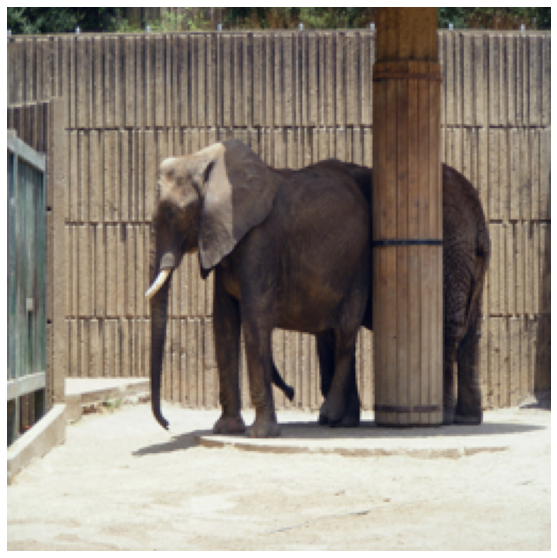

87it [08:11,  5.63s/it]

{'question_id': 262169001, 'answer': 'behind', 'question': ('where is the elephants trunk',), 'VCs': ('elephant exhibit zoo elephant adult elephants elephant enclosure elephant playing adult elephant zoo exhibit elephant trunk bull elephants elephant park group elephants zoo fence circus elephants elephants trunk wildlife exhibit',)}


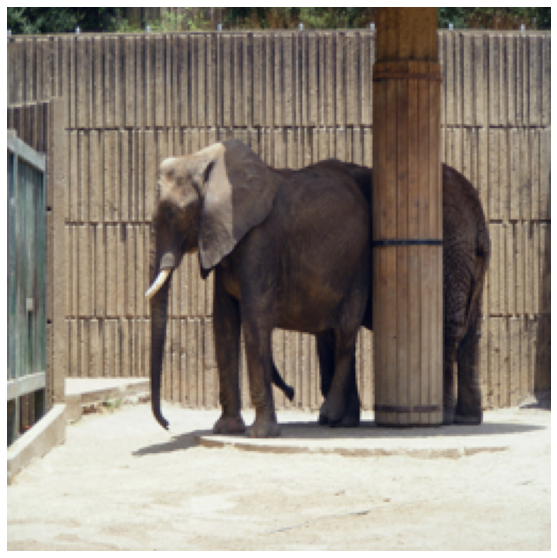

88it [08:16,  5.59s/it]

{'question_id': 262169002, 'answer': 'wood', 'question': ('what is the fence made of',), 'VCs': ('elephant exhibit zoo elephant adult elephants elephant enclosure elephant playing adult elephant zoo exhibit elephant trunk bull elephants elephant park group elephants zoo fence circus elephants elephants trunk wildlife exhibit',)}


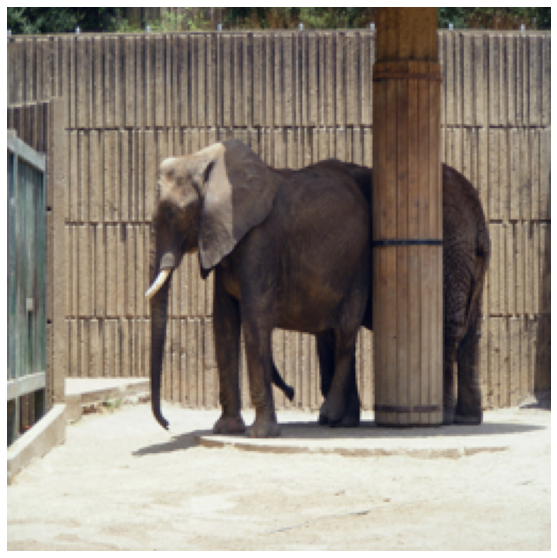

89it [08:22,  5.61s/it]

{'question_id': 262169003, 'answer': 'elephant', 'question': ('what kind of animal is this',), 'VCs': ('elephant exhibit zoo elephant adult elephants elephant enclosure elephant playing adult elephant zoo exhibit elephant trunk bull elephants elephant park group elephants zoo fence circus elephants elephants trunk wildlife exhibit',)}


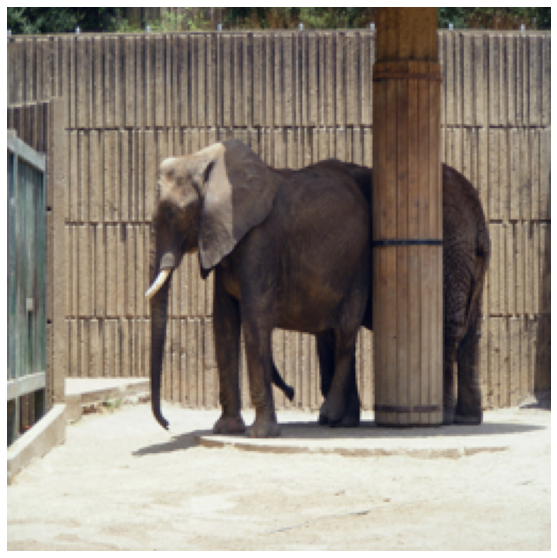

90it [08:27,  5.61s/it]

{'question_id': 262169004, 'answer': '6 feet', 'question': ('how tall is the fence',), 'VCs': ('elephant exhibit zoo elephant adult elephants elephant enclosure elephant playing adult elephant zoo exhibit elephant trunk bull elephants elephant park group elephants zoo fence circus elephants elephants trunk wildlife exhibit',)}


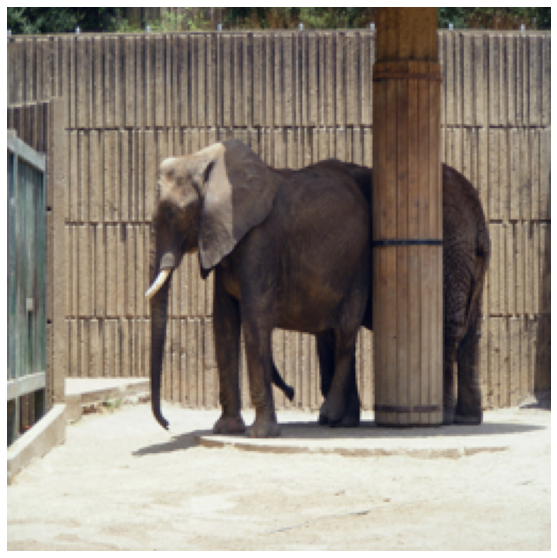

91it [08:33,  5.60s/it]

{'question_id': 262169005, 'answer': 'no', 'question': ('does this animal live in the wild',), 'VCs': ('elephant exhibit zoo elephant adult elephants elephant enclosure elephant playing adult elephant zoo exhibit elephant trunk bull elephants elephant park group elephants zoo fence circus elephants elephants trunk wildlife exhibit',)}


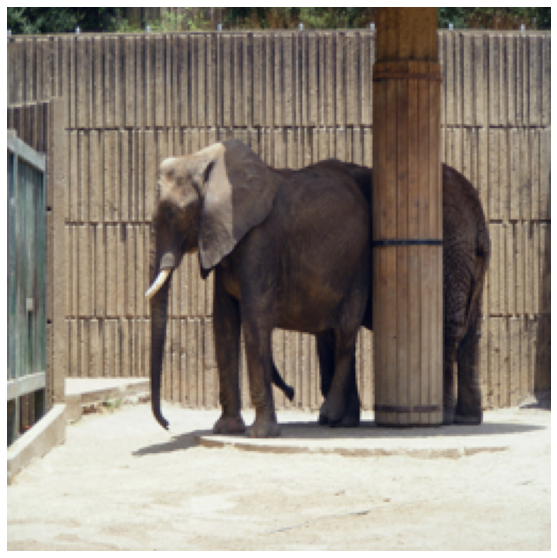

92it [08:39,  5.61s/it]

{'question_id': 262169006, 'answer': 'no', 'question': ('is there a baby elephant',), 'VCs': ('elephant exhibit zoo elephant adult elephants elephant enclosure elephant playing adult elephant zoo exhibit elephant trunk bull elephants elephant park group elephants zoo fence circus elephants elephants trunk wildlife exhibit',)}


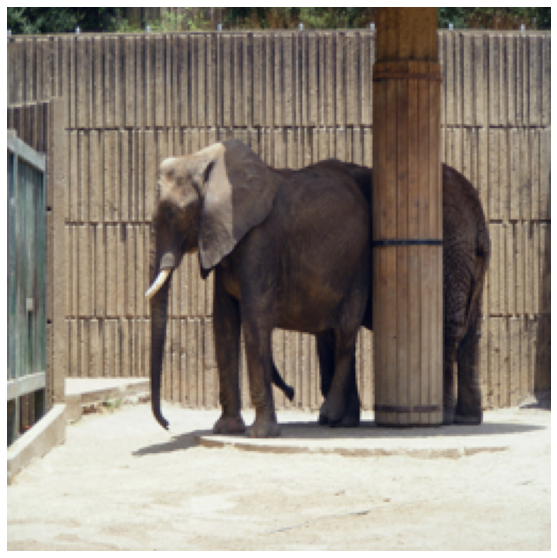

93it [08:44,  5.58s/it]

{'question_id': 262169007, 'answer': 'no', 'question': ('is there poop on the ground',), 'VCs': ('elephant exhibit zoo elephant adult elephants elephant enclosure elephant playing adult elephant zoo exhibit elephant trunk bull elephants elephant park group elephants zoo fence circus elephants elephants trunk wildlife exhibit',)}


In [ ]:
max_steps = 100
for n, (image, question, question_id) in tqdm(enumerate(test_loader)):   
    # if n < 10:
    #     continue
    image = image.to(device, non_blocking=True)   

    if config.get('kw_img_dataset', False):
        qs_input = tokenizer(question[0], padding='longest', truncation=True, max_length=25, return_tensors="pt").to(device) 
        kw_input = tokenizer(question[1], padding='longest', truncation=True, max_length=55, return_tensors="pt").to(device) 
        question_input = [qs_input, kw_input]
    else:
        question_input = tokenizer(question, padding='longest', truncation=True, max_length=25, return_tensors="pt").to(device) 
        
    topk_ids, topk_probs = model(image, question_input, answer_input, train=False, k=config['k_test'])  
    
    for ques_id, topk_id, topk_prob in zip(question_id, topk_ids, topk_probs):
        ques_id = int(ques_id.item())          
        _, pred = topk_prob.max(dim=0)
        print({"question_id":ques_id, "answer":test_loader.dataset.answer_list[topk_id[pred]], "question": question[0], "VCs": question[1]})  
        plt.figure(figsize=(10,10))
        plt.axis('off')
        plt.imshow(pytorch_to_pil(image))
        plt.show()
    if n > max_steps:
        break